# Image Processing and Analysis

--------------------------------

##Assignment 1

In [221]:
import numpy as np
import cv2 as cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from PIL import Image, ImageEnhance
import math

#Exercise 1#

a) Explain the impact of the following transformation function on a grayscale image, in terms of intensity values and brightness.

b) Verify your answer by a applying the transformation on an image of your choice (include
input/output images in your answer)

##Part 1##




Based on the given intensity value diagram, it is evident that the image's intensity values are categorized into 8 distinct levels after the transformation function is applied. If the original intensity falls within the ranges of 0-30, 30-60, 60-90, 90-120, 120-160, 160-190, 190-220, and 220-255, the intensity values of the transformed image will be 10, 20, 50, 70, 100, 140, 180, and 200, respectively. Therefore, the resulting grayscale image will only have intensity values of 10, 20, 50, 70, 100, 140, 180, and 200.

As a result, there will be no clear black or white areas in the image. The darkest intensity values will become even darker with values of 10, 20, 50, or 70. The middle intensity values will not change significantly, and will be normalized with values of 70, 100, and 140. The brighter intensity values will also be normalized with a value of 200.


##Part 2##

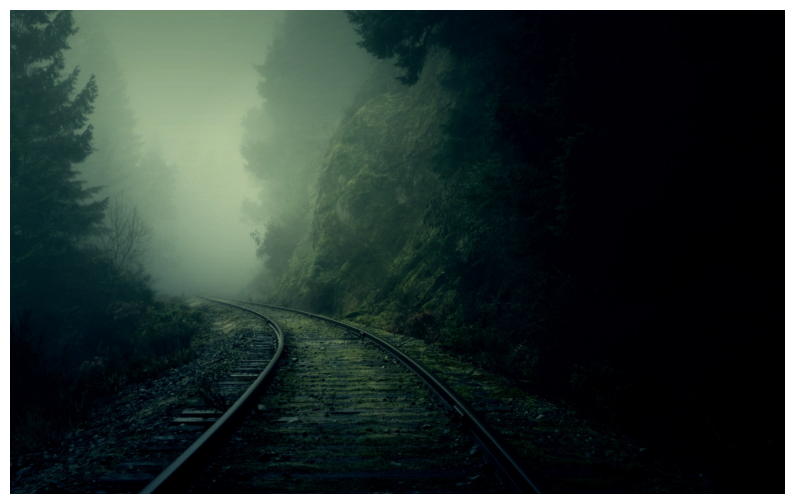

In [ ]:
im_random=cv2.imread('nature_dark_forest.jpg')

img_ex_1 = cv2.cvtColor(im_random, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(10, 8))
plt.imshow(img_ex_1)
plt.axis('off')
plt.show()

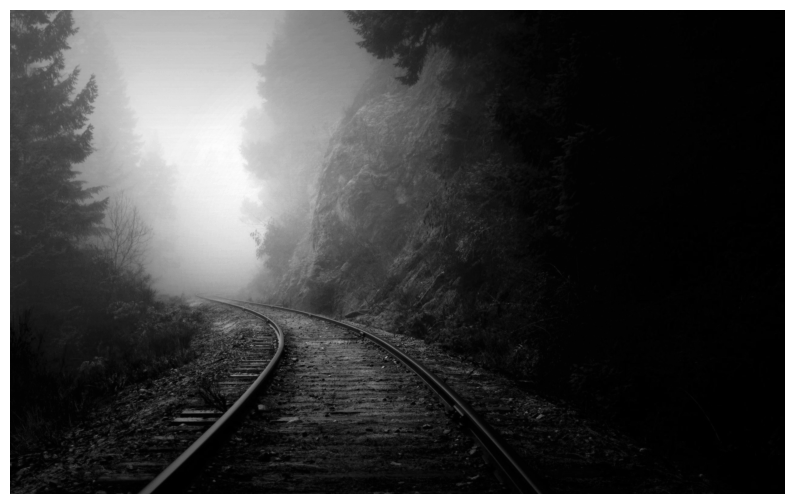

In [ ]:
gray_ex_1 = cv2.cvtColor(img_ex_1, cv2.COLOR_BGR2GRAY)

#cv2_imshow(gray)

plt.figure(figsize=(10, 8))
plt.imshow(gray_ex_1, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
list_of_pix = [0,30,60,90,120,160,190,220,255]
list_of_new_pix = [10,20,50,70,100,140,160,200,200]


In [ ]:
def pixel_trans(img, trans_param_list, transform_list):
  img = img.copy()
  for i in range(len(trans_param_list)):
    img[(img >= trans_param_list[i-1]) & (img < trans_param_list[i])] = transform_list[i]
  return img



In [ ]:
new_gray_ex_1 = pixel_trans(gray_ex_1,list_of_pix,list_of_new_pix)

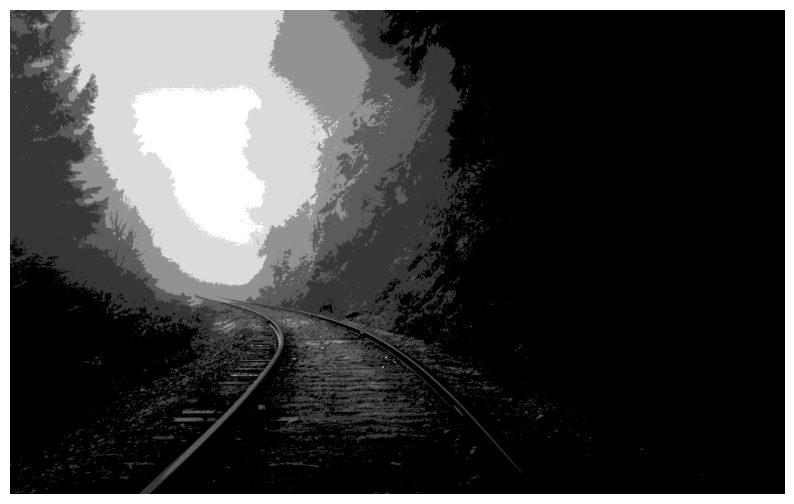

In [ ]:
#cv2_imshow(new_gray)

plt.figure(figsize=(10, 8))
plt.imshow(new_gray_ex_1, cmap='gray')
plt.axis('off')
plt.show()

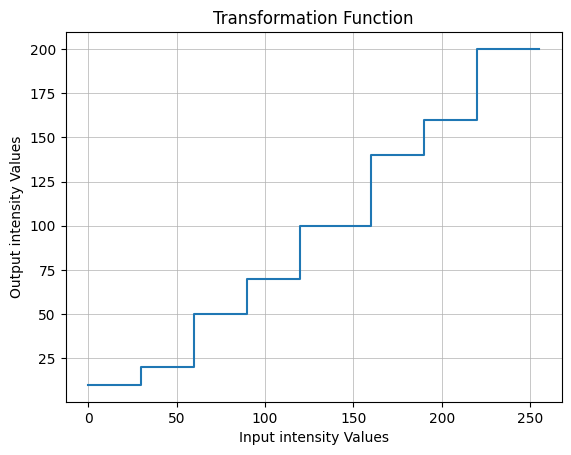

In [ ]:
plt.step(np.array(list_of_pix), np.array(list_of_new_pix), where='post')
plt.title("Transformation Function")
plt.xlabel("Input intensity Values")
plt.ylabel("Output intensity Values")
plt.grid(linewidth=0.5, which='both')
plt.show()

#Exercise 2#

Propose a method for enhancing the image “nature_dark_forest.jpg” in terms of the perceived light and color.

*Histogram Equilization*

Histogram equalization is a technique used to adjust the contrast and brightness of an image by redistributing its pixel values. The technique works by flattening the histogram of the image to make it more uniform, which results in a higher contrast image. It is especially useful when an image has an  unbalanced range of pixel values that result in a dull or low contrast image. By applying histogram equalization, the image can be transformed into an image with higher contrast and a more balanced range of pixel values, resulting in a more visually appealing image.

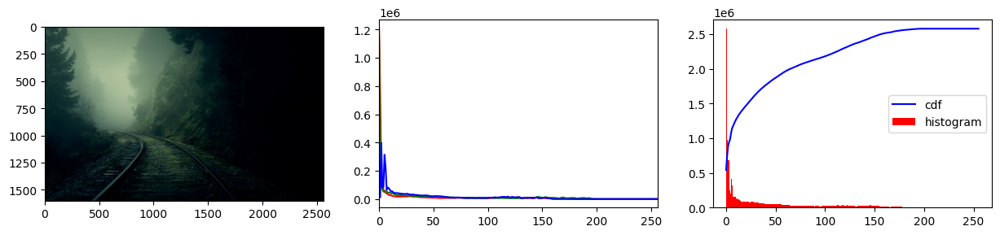

In [462]:
im_2 = cv2.imread("nature_dark_forest.jpg")

original_ex_2 = cv2.cvtColor(im_2, cv2.COLOR_BGR2RGB)

img_ex_2 = np.array(original_ex_2)

# Calculate the histogram of the image using 256 bins
hist, bins = np.histogram(original_ex_2.flatten(),256,[0,256])

# Calculate the cumulative sum of the histogram
cdf = hist.cumsum()

# Normalize the cumulative sum to be in the range [0, hist.max()]
cdf_normalized = cdf * hist.max()/ cdf.max()

fig, axes = plt.subplots(1, 3, figsize=(15,3))
plt.subplot(131), plt.imshow(img_ex_2)

color = ('r','g','b')
for i, col in enumerate(color):
    plt.subplot(132)
    hist = np.bincount(img_ex_2[:,:,i].ravel(), minlength=256) 
    plt.plot(hist,color = col)    

plt.xlim([0,256])
plt.subplot(133)
plt.plot(cdf_normalized, color = 'b')
plt.hist(original_ex_2.flatten(),256,[0,256], color = 'r')
plt.legend(('cdf','histogram'), loc = 'center right')
plt.show()




In [463]:
def color_hist_equalization(img):  
    # Split the image into separate color channels
    red, green, blue = cv2.split(img)

    # Apply histogram equalization to each color channel
    red_eq = cv2.equalizeHist(red)
    green_eq = cv2.equalizeHist(green)
    blue_eq = cv2.equalizeHist(blue)

    # Merge the color channels back into a single image
    img_eq = cv2.merge((red_eq, green_eq, blue_eq))

    # Convert image back to BGR color space for displaying with matplotlib
    img_eq = cv2.cvtColor(img_eq, cv2.COLOR_RGB2BGR)

    return img_eq


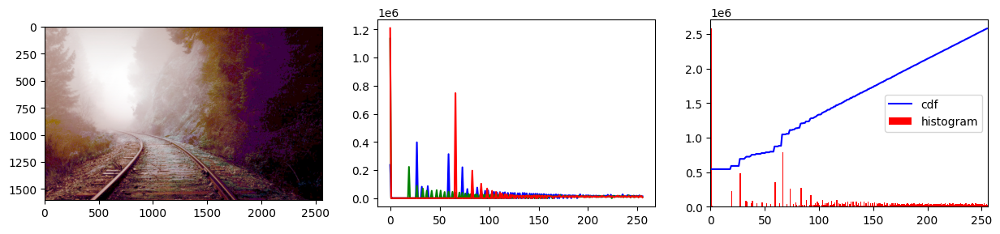

In [464]:
img_eq_2=color_hist_equalization(original_ex_2)

hist_light, bins = np.histogram(img_eq_2.flatten(),256,[0,256])
cdf = hist_light.cumsum()
cdf_normalized = cdf * hist_light.max()/ cdf.max()

fig, axes = plt.subplots(1, 3, figsize=(15,3))
plt.subplot(131)
plt.imshow(img_eq_2)

color = ('b','g','r')
for i, col in enumerate(color):
    plt.subplot(132)
    hist = np.bincount(img_eq_2[:,:,i].ravel(), minlength=256) 
    plt.plot(hist,color = col)    

plt.subplot(133)
plt.plot(cdf_normalized, color = 'b')
plt.hist(img_eq_2.flatten(),256,[0,256], color = 'r')
plt.legend(('cdf','histogram'), loc = 'center right')
plt.xlim([0,256])
plt.show()


#Exercise 3#

Propose a method for improving the image “pollen-500x430px-96dpi.jpg” in terms the perceived brightness.

##Way1##

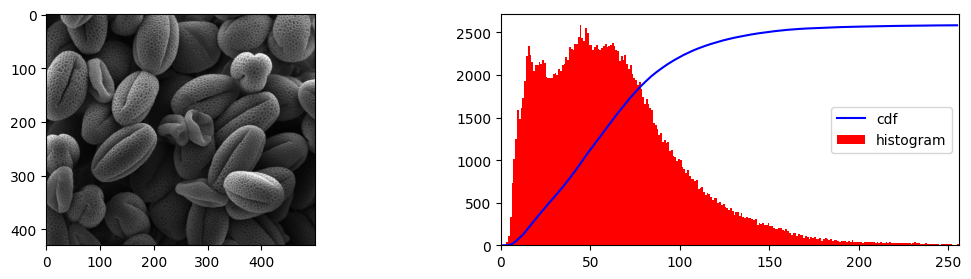

In [ ]:
img_ex_3 = cv2.imread('pollen-500x430px-96dpi.jpg', cv2.IMREAD_GRAYSCALE)

hist, bins = np.histogram(img_ex_3.flatten(),256,[0,256])

#Compute the cumulative distribution function (CDF) of the histogram
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121), plt.imshow(img_ex_3, cmap='gray')

plt.subplot(122)
plt.plot(cdf_normalized, color = 'b')
plt.hist(img_ex_3.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'center right')
plt.show()


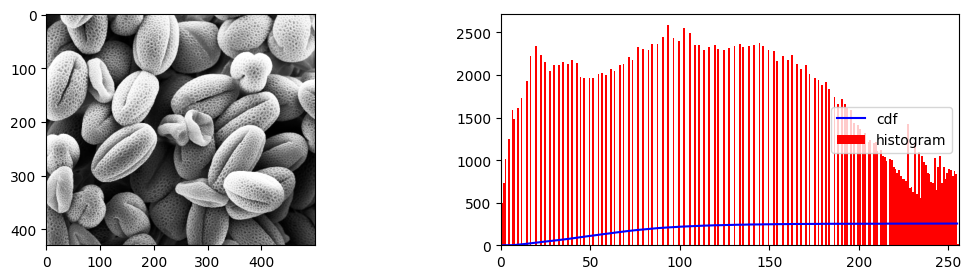

In [ ]:
# creates a masked array from the cdf
cdf_m = np.ma.masked_equal(cdf,0) 
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())

# fill the masked values in cdf_m with 0 and converts it to an unsigned 8-bit integer array 
cdf2 = np.ma.filled(cdf_m,0).astype('uint8')

img2 = cdf2[img_ex_3]

fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121), plt.imshow(img2, cmap='gray')

plt.subplot(122)
plt.plot(cdf2, color = 'b')
plt.hist(img2.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'center right')
plt.show()

##Way 2##

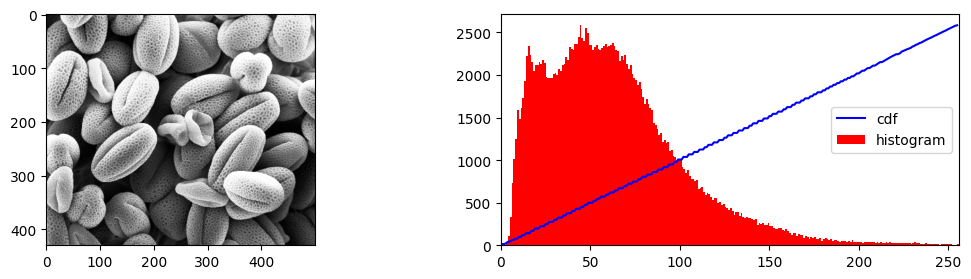

In [ ]:
equ = cv2.equalizeHist(img_ex_3)

hist, bins = np.histogram(equ.flatten(),256,[0,256])

cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()

fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121), plt.imshow(equ, cmap='gray')

plt.subplot(122)
plt.plot(cdf_normalized, color = 'b')
plt.hist(img_ex_3.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'center right')
plt.show()

#Exersice 4#

Propose a method for sharpening the image“First-photo-of-the-moon-from-Chandrayaan-
2_ISRO.jpg”.

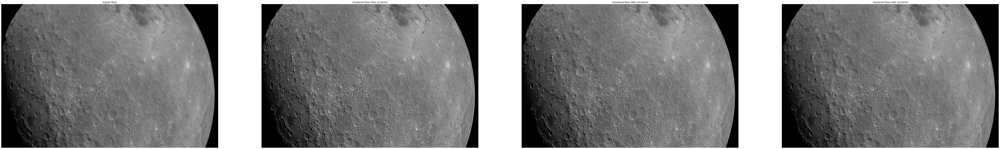

In [ ]:
im_ex_4 = cv2.imread('First-photo-of-the-moon-from-Chandrayaan-2_ISRO.jpg')

#constructing kernels and try different sharpening filters
kernel1 = np.array([[-1, -1, -1], [-1, 9,-1], [-1, -1, -1]])
kernel2 = np.array([[-1, 0, -1], [0, 5,0], [-1, 0, -1]])
kernel3 = np.array([[0, -1, 0], [-1, 5,-1], [0, -1, 0]])



image_sharp1 = cv2.filter2D(src=im_ex_4, ddepth=-1, kernel=kernel1)
image_sharp2 = cv2.filter2D(src=im_ex_4, ddepth=-1, kernel=kernel2)
image_sharp3 = cv2.filter2D(src=im_ex_4, ddepth=-1, kernel=kernel3)


fig, axes = plt.subplots(1, 4, figsize=(100,100))
plt.subplot(141), plt.imshow(im_ex_4),plt.axis('off'),plt.title('0riginal Moon')
plt.subplot(142), plt.imshow(image_sharp1),plt.axis('off'),plt.title('Sharpened Moon With 1st Kernel')
plt.subplot(143), plt.imshow(image_sharp2),plt.axis('off'),plt.title('Sharpened Moon With 2nd Kernel')
plt.subplot(144), plt.imshow(image_sharp3),plt.axis('off'),plt.title('Sharpened Moon With 3rd Kernel')
plt.show()

The above kernels sharps the image differently. The kernel1 is better than the others at the specific image. 

# Exercise 5#
One combined spatial enhancement methods (e.g. arithmetic operations, gray level
transformations, and/or sharpening spatial filters) to convert “image_1” to “image_2”.

a) Try to guess the processing steps she adopted. [Note the dynamic range and brightness of
the enhanced image, and the noise introduced.]

b) Propose a pipeline of processes with the aim of approximating “image_1” starting from
“image_2”.

In [ ]:
im_ex_5_1=cv2.imread('image_1.jpg',0)
im_ex_5_2=cv2.imread('image_2.jpg',0)

##Part 1##

In [ ]:
target = im_ex_5_2.copy()

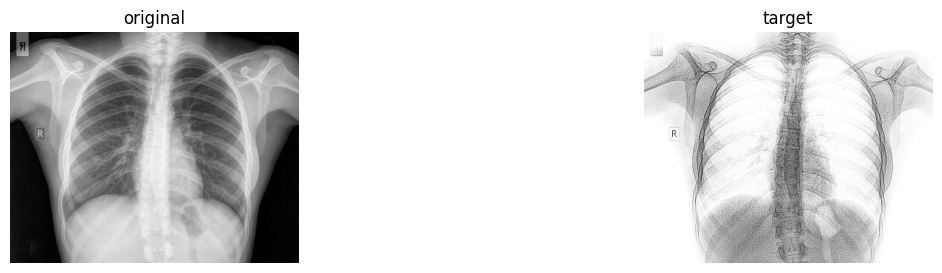

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(15,3))
plt.subplot(121), 
plt.imshow(im_ex_5_1, cmap='gray'),
plt.axis('off') ,
plt.title('original')

plt.subplot(122),
plt.imshow(target, cmap='gray'),
plt.axis('off') ,
plt.title('target')
plt.show()

*Gamma Correction*

I will try to apply gamma correction to find the best fit of the brightmess.

Gamma correction is known as the *Power Law Transform*. First, our image pixel intensities must be scaled from the range [0, 255] to [0, 1.0]. From there, we obtain our output gamma corrected image by applying the following equation:

$$
O = I^{(1 / G)}
$$
where I is our input image and G is our gamma value. The output image O is then scaled back to the range [0, 255].

Gamma values < 1 will shift the image towards the darker end of the spectrum, while gamma values > 1 will make the image appear lighter. Gamma value of 1 will have no affect on the input image.

In Image_2, we can observe that the bones in front of the lungs appear faded. Since these bones are brighter than the vertebrae, I want to make them darker using gamma correction with gamma smaller than one. This is to ensure that they are as similar as possible to the resulting image after the negative step, which will be applied next.


Text(0.5, 1.0, 'Gamma = 0.8')

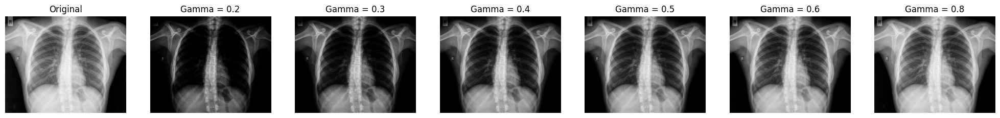

In [ ]:
def adjust_gamma(image, gamma):
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255
        for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(image, table)

fig, axes = plt.subplots(1, 7, figsize=(25,25))
plt.subplot(1, 7, 1), 
plt.imshow(im_ex_5_1, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Original')

gamma = 0.2
adjusted1 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 2), 
plt.imshow(adjusted1, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.2')

gamma = 0.3
adjusted2 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 3), 
plt.imshow(adjusted2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.3')

gamma = 0.4
adjusted3 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 4), 
plt.imshow(adjusted3, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.4')

gamma = 0.5
adjusted4 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 5), 
plt.imshow(adjusted4, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.5')

gamma = 0.6
adjusted5 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 6), 
plt.imshow(adjusted5, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.6')

gamma = 0.8
adjusted6 = adjust_gamma(im_ex_5_1, gamma=gamma)
plt.subplot(1, 7, 7), 
plt.imshow(adjusted6, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.8')

The best image seems to be the adjusted2.


*Compement*

First I will use the Compement graysxale to transform the image to negative. 
Can be obtained by subtracting from 255 the values of the image
$$
y = 255 - x 
$$

Negative values are clipped to 0.

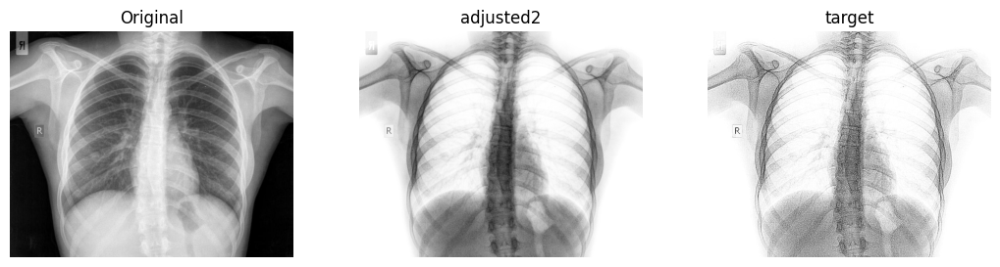

In [ ]:
neg = (255-adjusted2)

fig, axes = plt.subplots(1, 3, figsize=(13,3))

plt.subplot(131), 
plt.imshow(im_ex_5_1, cmap='gray'), 
plt.axis('off'), 
plt.title('Original')

plt.subplot(132), 
plt.imshow(neg, cmap='gray'), 
plt.axis('off'), 
plt.title('adjusted2')

plt.subplot(133), 
plt.imshow(target, cmap='gray'), 
plt.axis('off'), 
plt.title('target')
plt.show()

*Sharpening*

The adjusted image appears to be smooth, so I would like to sharpen it slightly to make it less smooth. 

To do that i will try kernels from Exercise 4. 

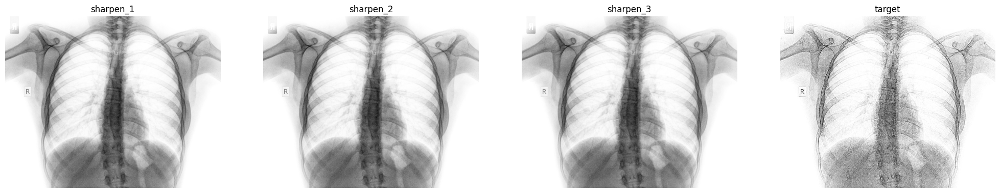

In [ ]:
kernel1 = np.array([[-1, -1, -1], [-1, 9,-1], [-1, -1, -1]])
kernel2 = np.array([[-1, 0, -1], [0, 5,0], [-1, 0, -1]])
kernel3 = np.array([[0, -1, 0], [-1, 5,-1], [0, -1, 0]])


sharpen_1 = cv2.filter2D(src=neg, ddepth=-1, kernel=kernel1)
sharpen_2 = cv2.filter2D(src=neg, ddepth=-1, kernel=kernel2)
sharpen_3 = cv2.filter2D(src=neg, ddepth=-1, kernel=kernel3)


fig, axes = plt.subplots(1, 4, figsize=(25,25))

plt.subplot(141), 
plt.imshow(neg, cmap='gray'), 
plt.axis('off'), 
plt.title('sharpen_1')

plt.subplot(142), 
plt.imshow(neg, cmap='gray'), 
plt.axis('off'), 
plt.title('sharpen_2')

plt.subplot(143), 
plt.imshow(neg, cmap='gray'), 
plt.axis('off'), 
plt.title('sharpen_3')

plt.subplot(144), 
plt.imshow(target, cmap='gray'), 
plt.axis('off'), 
plt.title('target')
plt.show()

*Gaussian noise* 

Gaussian noise is a type of statistical noise that is often added to digital images. It is caused by random variations in the intensity values of the pixels in the image.

I will add Gaussian noise to the image to create some distortion.

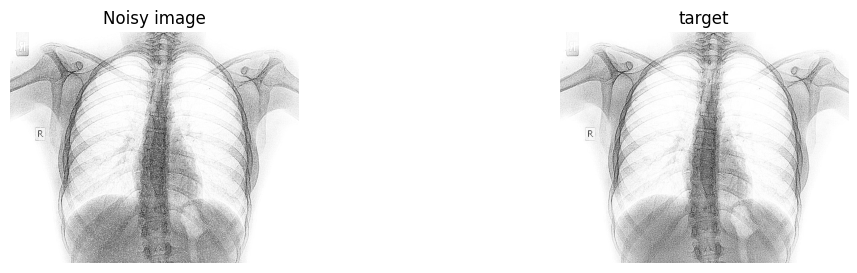

In [ ]:
mean = 0
var = 0.1
sigma = var ** 0.2
gaussian = np.random.normal(mean, sigma, sharpen_1.shape)
gaussian = gaussian.reshape(sharpen_1.shape).astype('uint8')

# Add Gaussian noise to image
noisy_img = cv2.add(sharpen_1, gaussian)


fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121), 
plt.imshow(noisy_img, cmap='gray'), 
plt.axis('off'), 
plt.title('Noisy image')

plt.subplot(122), 
plt.imshow(target, cmap='gray'), 
plt.axis('off'), 
plt.title('target')
plt.show()

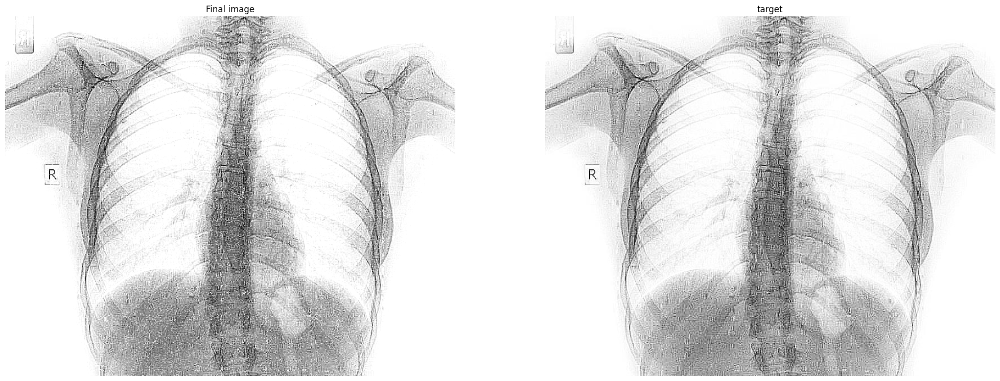

In [ ]:
final_img = cv2.add(noisy_img, 10)

fig, axes = plt.subplots(1, 2, figsize=(25,25))

plt.subplot(121), 
plt.imshow(final_img, cmap='gray'), 
plt.axis('off'), 
plt.title('Final image')

plt.subplot(122),
plt.imshow(target, cmap='gray'), 
plt.axis('off'), 
plt.title('target')
plt.show()

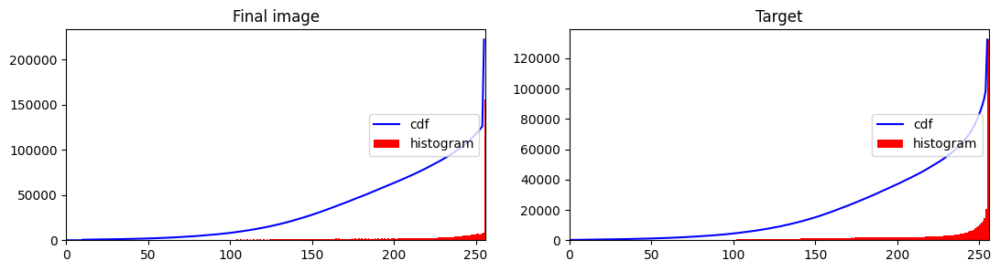

In [ ]:
hist_of_init, bins = np.histogram(final_img.flatten(),256,[0,256])
hist_target, bins = np.histogram(target.flatten(),256,[0,256])

cdf_1 = hist_of_init.cumsum()
cdf_2 = hist_target.cumsum()


cdf_normalized_1 = cdf_1 * hist_of_init.max()/ cdf_1.max()
cdf_normalized_2 = cdf_2 * hist_target.max()/ cdf_2.max()

fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121)
plt.plot(cdf_normalized_1, color = 'b')
plt.hist(noisy_img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.title('Final image')
plt.legend(('cdf','histogram'), loc = 'center right')

plt.subplot(122)
plt.plot(cdf_normalized_2, color = 'b')
plt.hist(target.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'center right')
plt.title('Target')
plt.show()

This is as far as i can get.

##Part 2##

In [ ]:
target = im_ex_5_1.copy()

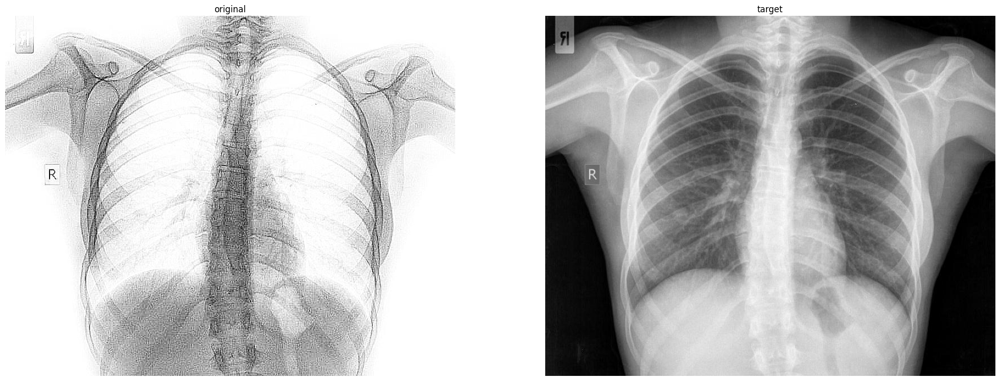

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(25,25))
plt.subplot(121), 
plt.imshow(im_ex_5_2, cmap='gray'),
plt.axis('off') ,
plt.title('original')

plt.subplot(122), 
plt.imshow(target, cmap='gray'),
plt.axis('off'),
plt.title('target')
plt.show()

*Gamma Correction*

To find the best brightness and contrast analogy of the pixels.

Text(0.5, 1.0, 'Gamma = 2')

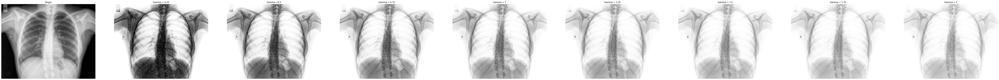

In [ ]:
original_img=im_ex_5_2.copy()

fig, axes = plt.subplots(1, 9, figsize=(100,100))
plt.subplot(191), 
plt.imshow(target, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Target')

gamma = 0.25
adjusted1_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(192), 
plt.imshow(adjusted1_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.25')

gamma = 0.5
adjusted2_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(193), 
plt.imshow(adjusted2_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma =0.5')

gamma = 0.75
adjusted3_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(194), 
plt.imshow(adjusted3_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 0.75')

gamma = 1
adjusted4_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(195), 
plt.imshow(adjusted4_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1')

gamma = 1.25
adjusted5_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(196), 
plt.imshow(adjusted5_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1.25')

gamma = 1.5
adjusted6_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(197), 
plt.imshow(adjusted6_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1.5')

gamma = 1.75
adjusted7_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(198), 
plt.imshow(adjusted7_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1.75')

gamma = 2
adjusted8_2 = adjust_gamma(original_img, gamma=gamma)
plt.subplot(199), 
plt.imshow(adjusted8_2, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 2')

I believe that the best analogy is illustrated using gamma 0.5 at image adjusted2_2

*Gaussian filter*

Gaussian ﬁlters are a class of low pass ﬁlters, all based on the Gaussian probability distribution function
$$
f(x) = e^{(x^2+y^2)/(2\sigma^2)}
$$

where $σ$ is the standard deviation: a large value of $σ$ produces to a ﬂatter curve, and a
small value leads to a “pointier” curve. 

Initially, we can observe that the original image contains numerous points that appear as dots. Therefore, we need to blur it out to better match the distribution of pixels in the target image. 

(-0.5, 799.5, 640.5, -0.5)

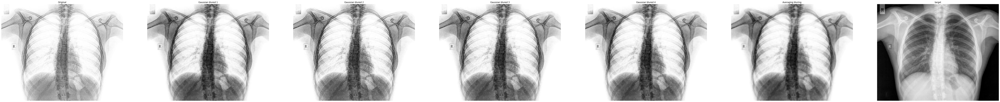

In [ ]:
fig, axes = plt.subplots(1, 7, figsize=(100,100))
plt.subplot(171), 
plt.imshow(im_ex_5_2, cmap='gray'), 
plt.title('Original'), 
plt.axis('off')

blur_1 = cv2.GaussianBlur(adjusted2_2,(7,7),0)
plt.subplot(172), 
plt.imshow(blur_1, cmap='gray'), 
plt.title('Gaussian blured 1'), 
plt.axis('off')

blur_2= cv2.GaussianBlur(adjusted2_2,(7,7),0.5)
plt.subplot(173),
plt.imshow(blur_2, cmap='gray'), 
plt.title('Gaussian blured 2'), 
plt.axis('off')

blur_3 = cv2.GaussianBlur(adjusted2_2,(7,7),1)
plt.subplot(174), 
plt.imshow(blur_3, cmap='gray'), 
plt.title('Gaussian blured 3'), 
plt.axis('off')

blur_4 = cv2.GaussianBlur(adjusted2_2,(7,7),1.5)
plt.subplot(175), 
plt.imshow(blur_4, cmap='gray'), 
plt.title('Gaussian blured 4'), 
plt.axis('off')

average = cv2.blur(adjusted2_2,(7,7))
plt.subplot(176), 
plt.imshow(average, cmap='gray'), 
plt.title('Averaging bluring'), 
plt.axis('off')

plt.subplot(177), 
plt.imshow(target, cmap='gray'), 
plt.title('target'), 
plt.axis('off')

We can observe that the image blur_3 looks smooth enough to fit the target image.




*Compement*

I will apply the complement to get a better understanding of the next necessary steps.

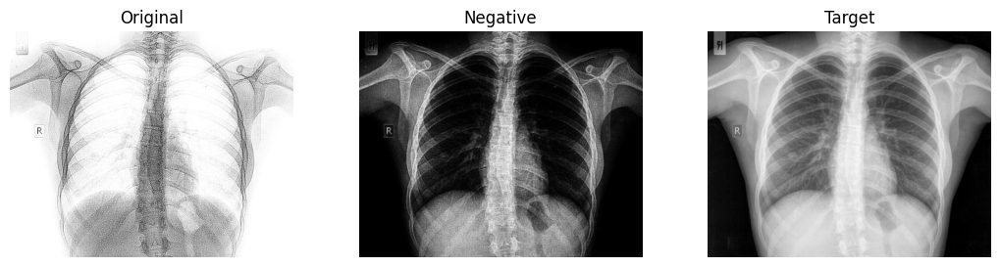

In [ ]:
neg_part_2 = (255-blur_3)

fig, axes = plt.subplots(1, 3, figsize=(13,3))

plt.subplot(131), 
plt.imshow(im_ex_5_2, cmap='gray'), 
plt.axis('off'), 
plt.title('Original')

plt.subplot(132), 
plt.imshow(neg_part_2, cmap='gray'), 
plt.axis('off'), 
plt.title('Negative')

plt.subplot(133), 
plt.imshow(target, cmap='gray'), 
plt.axis('off'), 
plt.title('Target')
plt.show()

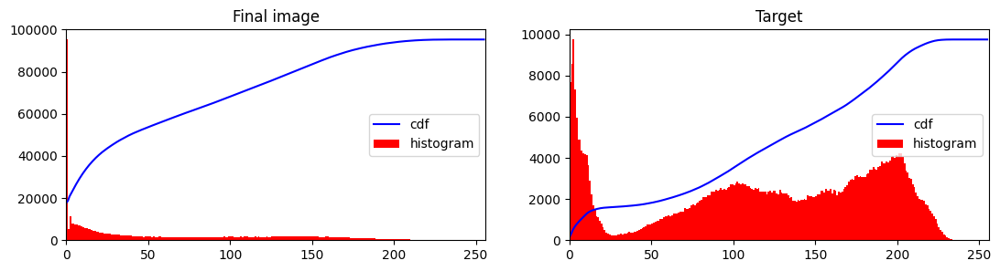

In [ ]:
hist_of_neg, bins = np.histogram(neg_part_2.flatten(),256,[0,256])
hist_target, bins = np.histogram(target.flatten(),256,[0,256])

cdf_1 = hist_of_neg.cumsum()
cdf_2 = hist_target.cumsum()

cdf_normalized_1 = cdf_1 * hist_of_neg.max()/ cdf_1.max()
cdf_normalized_2 = cdf_2 * hist_target.max()/ cdf_2.max()

fig, axes = plt.subplots(1, 2, figsize=(13,3))

plt.subplot(121)
plt.plot(cdf_normalized_1, color = 'b')
plt.hist(neg_part_2.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.title('Final image')
plt.legend(('cdf','histogram'), loc = 'center right')

plt.subplot(122)
plt.plot(cdf_normalized_2, color = 'b')
plt.hist(target.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'center right')
plt.title('Target')
plt.show()

It is obvious that fisrt we have to do some histogram equalization

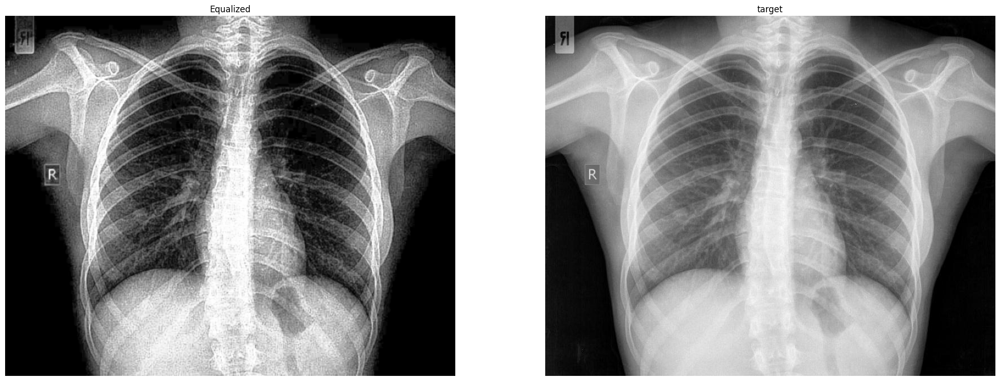

In [ ]:
cdf_m = np.ma.masked_equal(cdf_1,0) 
cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
cdf2 = np.ma.filled(cdf_m,0).astype('uint8')

equil = cdf2[neg_part_2]

fig, axes = plt.subplots(1, 2, figsize=(25,25))
plt.subplot(121), 
plt.imshow(equil, cmap='gray'),
plt.axis('off') ,
plt.title('Equalized')

plt.subplot(122), 
plt.imshow(target, cmap='gray'),
plt.axis('off'),
plt.title('target')
plt.show()

It is obvious that we have to increase the brightness and also smooth the details a little. 


*Median Filter*

The filtered image takes median of all the pixels under kernel area and central element is replaced with this median value. This is highly effective against salt-and-pepper noise in the images. It reduces the noise effectively. 

I will try to smooth the details of the image using the Median filter.

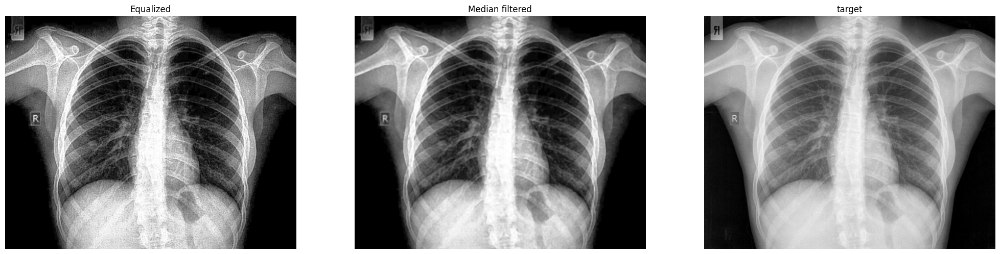

In [ ]:
median = cv2.medianBlur(equil,5)

fig, axes = plt.subplots(1, 3, figsize=(25,25))
plt.subplot(131), 
plt.imshow(equil, cmap='gray'),
plt.axis('off') ,
plt.title('Equalized')

plt.subplot(132), 
plt.imshow(median, cmap='gray'),
plt.axis('off') ,
plt.title('Median filtered')

plt.subplot(133), 
plt.imshow(target, cmap='gray'),
plt.axis('off'),
plt.title('target')
plt.show()

Lets use some Gamma correction again to make it brighter. 

Text(0.5, 1.0, 'Gamma = 3')

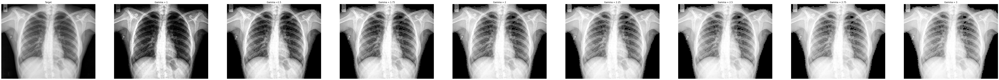

In [ ]:
fig, axes = plt.subplots(1, 9, figsize=(100,100))
plt.subplot(191), 
plt.imshow(target, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Target')

gamma = 1
adjusted1_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(192), 
plt.imshow(adjusted1_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1')

gamma = 1.5
adjusted2_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(193), 
plt.imshow(adjusted2_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma =1.5')

gamma = 1.75
adjusted3_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(194), 
plt.imshow(adjusted3_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 1.75')

gamma = 2
adjusted4_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(195), 
plt.imshow(adjusted4_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 2')

gamma = 2.25
adjusted5_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(196), 
plt.imshow(adjusted5_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 2.25')

gamma = 2.5
adjusted6_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(197), 
plt.imshow(adjusted6_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 2.5')

gamma = 2.75
adjusted7_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(198), 
plt.imshow(adjusted7_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 2.75')

gamma = 3
adjusted8_22 = adjust_gamma(median, gamma=gamma)
plt.subplot(199), 
plt.imshow(adjusted8_22, cmap = 'gray'), 
plt.axis('off'), 
plt.title('Gamma = 3')

*Unsharpe*

The idea of unsharp masking is to subtract a scaled “unsharp” version of the image from the original.

In practice, we can achieve this aﬀect by subtracting a scaled blurred image from the original.

The unsharp ﬁlter has the form

$$
\frac{1}{α+1} \left[\begin{array}
{rrr}
-α & α-1 & -α \\
α-1 & α+5 & α-1 \\
-α & α-1 & -α
\end{array}\right]
$$


I use it here to fix the not smoothed parts in the peripheral area of the thorax. 

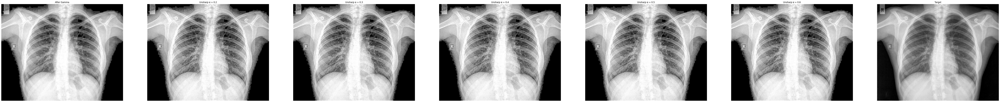

In [ ]:
def unsharp(alpha):
    A1 = np.array([[-1,1,-1],[1,1,1],[-1,1,-1]])
    A2 = np.array([[0,-1,0],[-1,5,-1],[0,-1,0]])
    return (alpha*A1+A2)/(alpha+1)

fig, axes = plt.subplots(1, 7, figsize=(100,100))
plt.subplot(171), 
plt.imshow(adjusted5_22, cmap='gray'), 
plt.title('After Gamma'), 
plt.axis('off')

kernel = unsharp(0.05)
unsharped_1 = cv2.filter2D(adjusted5_22, -1, kernel, borderType=cv2.BORDER_CONSTANT)
plt.subplot(172),
plt.imshow(unsharped_1, cmap='gray'), 
plt.title('Unsharp α = 0.2'), 
plt.axis('off')

kernel = unsharp(0.1)
unsharped_2 = cv2.filter2D(adjusted5_22, -1, kernel, borderType=cv2.BORDER_CONSTANT)
plt.subplot(173), 
plt.imshow(unsharped_2, cmap='gray'), 
plt.title('Unsharp α = 0.3'), 
plt.axis('off')

kernel = unsharp(0.15)
unsharped_3 = cv2.filter2D(adjusted5_22, -1, kernel, borderType=cv2.BORDER_CONSTANT)
plt.subplot(174), 
plt.imshow(unsharped_3, cmap='gray'), 
plt.title('Unsharp α = 0.4'), 
plt.axis('off')

kernel = unsharp(0.2)
unsharped_4 = cv2.filter2D(adjusted5_22, -1, kernel, borderType=cv2.BORDER_CONSTANT)
plt.subplot(175), 
plt.imshow(unsharped_4, cmap='gray'), 
plt.title('Unsharp α = 0.5'), 
plt.axis('off')

kernel = unsharp(0.25)
unsharped_5 = cv2.filter2D(adjusted5_22, -1, kernel, borderType=cv2.BORDER_CONSTANT)
plt.subplot(176), 
plt.imshow(unsharped_5, cmap='gray'), 
plt.title('Unsharp α = 0.6'), 
plt.axis('off')

plt.subplot(177), 
plt.imshow(target, cmap='gray'), 
plt.title('Target'), 
plt.axis('off')

plt.show()


Actually, the after gamma image looks better than the unsharpened ones. So, I will apply Gaussian filters again to blur it and check if it fits better with the target image.

So the final image is the adjusted4_2.


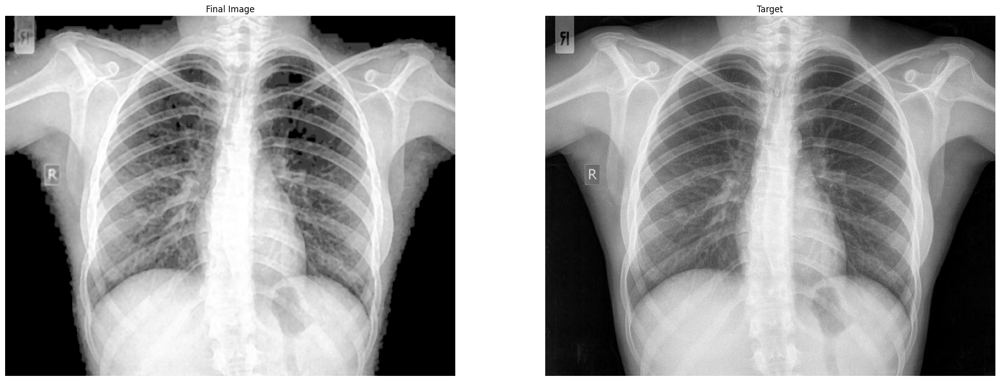

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(25,25))
plt.subplot(121), plt.imshow(adjusted5_22, cmap='gray'),plt.axis('off') ,plt.title('Final Image')
plt.subplot(122), plt.imshow(target, cmap='gray'),plt.axis('off'),plt.title('Target')
plt.show()

Τhe result is obviously not ideal, but the image has been transformed enough without losing too much detail.

# Exercise 6# 

a. Find the main edges of image11.jpg.

b. Estimate the angle (with respect to the horizontal axis) of the diagonal edges of the roof.

c. Find the corners of the image11.jpg.

d. Based on the detected corners, locate the windows.

In [ ]:
im_ex_6=cv2.imread('image11.jpg')

## Part 1 ##

(<matplotlib.image.AxesImage at 0x7f03379378b0>, (-0.5, 499.5, 573.5, -0.5))

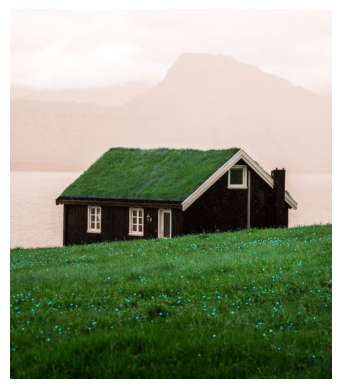

In [467]:
plt.imshow(im_ex_6), plt.axis('off')

To find the edges there are several ways. 

The first is to use *high pass filters*.

It will be convenient to have some standard terminology by which we can discuss the
eﬀects a ﬁlter will have on an image, and to be able to choose the most appropriate ﬁlter
for a given image processing task. One important aspect of an image which enables us to
do this is the notion of frequencies. Roughly speaking, the frequencies of an image are a
measure of the amount by which gray values change with distance. 

High frequency components are characterized by large changes in gray values over small distances; 
examples of high frequency components
are edges and noise.

**High pass ﬁlters** let the high frequency components pass, and reduces or elimi-
nates low frequency components.

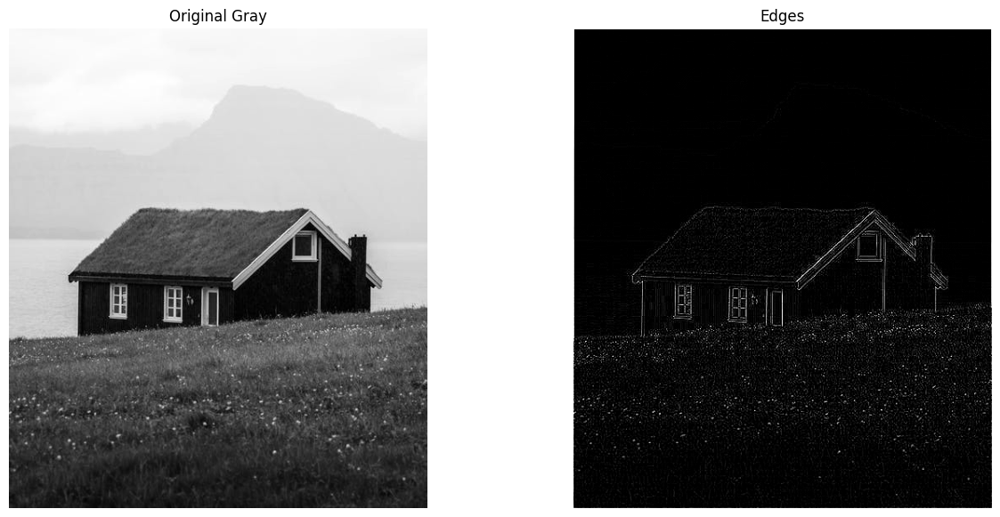

In [468]:
# Convert to grayscale
gray = cv2.cvtColor(im_ex_6, cv2.COLOR_BGR2GRAY)

fig, axes = plt.subplots(1, 2, figsize=(15,7))

# Gray image
plt.subplot(121)
plt.imshow(gray, cmap='gray')
plt.title('Original Gray')
plt.axis('off')

# High pass filter
kernel = np.array([[0,-1,0],[-1,4,-1],[0,-1,0]], np.float32)
edges_1 = cv2.filter2D(gray, -1, kernel, borderType=cv2.BORDER_CONSTANT)

plt.subplot(122)
plt.imshow(edges_1, cmap='gray')
plt.title('Edges')
plt.axis('off')

plt.show()


An other approach is to use the *Canny algorithm*.

The Canny function requires three things: the grayscale image, the lower and higher pixel threshold values to be taken into consideration   - I used (120,200).

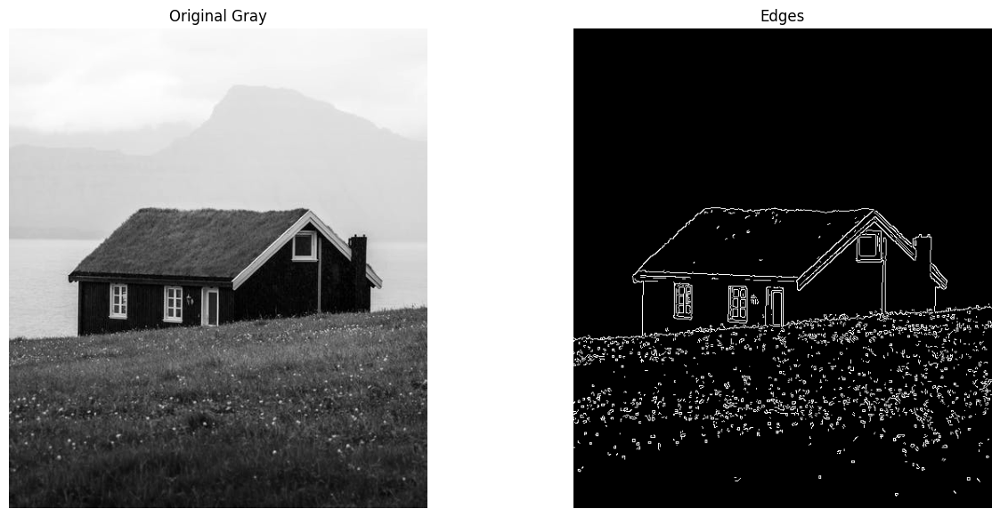

In [469]:
# Apply canny edge detection
edges_2 = cv2.Canny(gray, 150, 200, apertureSize=3)

fig, axes = plt.subplots(1, 2, figsize=(15,7))

# Gray image
plt.subplot(121)
plt.imshow(gray, cmap='gray')
plt.title('Original Gray')
plt.axis('off')

# High pass filter
kernel = np.array([[0,-1,0],[-1,4,-1],[0,-1,0]], np.float32)
edges_1 = cv2.filter2D(gray, -1, kernel, borderType=cv2.BORDER_CONSTANT)

plt.subplot(122)
plt.imshow(edges_2, cmap='gray')
plt.title('Edges')
plt.axis('off')

plt.show()

I will keep the edges_2 because is more clear than edges_1.

## Part 2##

*Dilate*

The dilate function is used to dilate or thicken the edges detected by the Canny edge detector.

This process expands the boundaries of the edges, effectively making them fatter or thicker. The size of the kernel determines how much thicker the edges become.

I chose a kernel with (1,1) shape, because i didn't want to make the lines too intense.

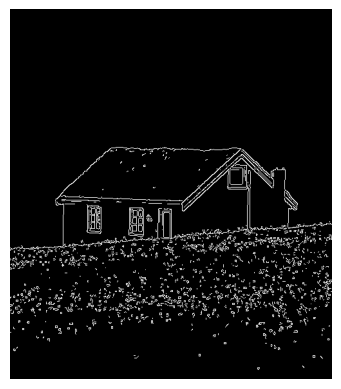

In [470]:
kernel = np.ones((1, 1), np.uint8)
edges_dilated = cv2.dilate(edges_2, kernel)

plt.imshow(edges_dilated, cmap='gray')
plt.axis('off')

plt.show()

*HoughLines*

To detect and determine the angles of the desired lines, I utilized the HoughLines function.

The HoughLines function is a computer vision technique used to detect straight lines in an image. It works by mapping points in the image space to lines in the parameter space, where each point corresponds to a line in the parameter space. 

In [ ]:
# This returns an array of r and theta values
lines = cv2.HoughLines(edges_dilated, rho=1 ,theta=0.001, threshold=75)# , min_theta=0, max_theta=np.pi/3)

drawn_img=im_ex_6.copy()
# The below for loop runs till r and theta values
# are in the range of the 2d array

for r_theta in lines:
    arr = np.array(r_theta[0], dtype=np.float64)
    r, theta = arr
    #print(theta)
    angle_degrees = theta * 180 / np.pi
    if  90.1 <= angle_degrees <= 90.3 :
        # Stores the value of cos(theta) in a
        a = np.cos(theta)
        # Stores the value of sin(theta) in b
        b = np.sin(theta)
        # x0 stores the value rcos(theta)
        x0 = a*r
        # y0 stores the value rsin(theta)
        y0 = b*r
        # x1 stores the rounded off value of (rcos(theta)-1000sin(theta))
        x1 = int(x0 + 1000*(-b))
        # y1 stores the rounded off value of (rsin(theta)+1000cos(theta))
        y1 = int(y0 + 1000*(a))
        # x2 stores the rounded off value of (rcos(theta)+1000sin(theta))
        x2 = int(x0 - 1000*(-b))
        # y2 stores the rounded off value of (rsin(theta)-1000cos(theta))
        y2 = int(y0 - 1000*(a))
        # cv2.line draws a line in img from the point(x1,y1) to (x2,y2).
        # (0,0,255) denotes the colour of the line to be
        # drawn. In this case, it is red.
        drawn_img=im_ex_6.copy()
        cv2.line(drawn_img, (x1, y1), (x2, y2), (0, 0, 255), 2)
        plt.imshow(drawn_img)
        plt.show()

    elif 46 <= angle_degrees <= 47 : 
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a*r
        y0 = b*r
        x1 = int(x0 + 1000*(-b))
        y1 = int(y0 + 1000*(a))
        x2 = int(x0 - 1000*(-b))
        y2 = int(y0 - 1000*(a))
        drawn_img=im_ex_6.copy()
        cv2.line(drawn_img, (x1, y1), (x2, y2), (0, 0, 255), 2) 
        plt.imshow(drawn_img)
        plt.show()

    elif 135 <= angle_degrees <= 138:
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a*r
        y0 = b*r
        x1 = int(x0 + 1000*(-b))
        y1 = int(y0 + 1000*(a))
        x2 = int(x0 - 1000*(-b))
        y2 = int(y0 - 1000*(a)) 
        drawn_img=im_ex_6.copy()
        cv2.line(drawn_img, (x1, y1), (x2, y2), (0, 0, 255), 2) 
        plt.imshow(drawn_img)   
        plt.show()      

        



We can observe that approximately:

the angle 

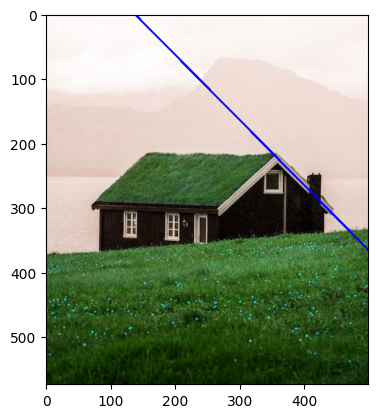

is 42~44  degrees.

The 

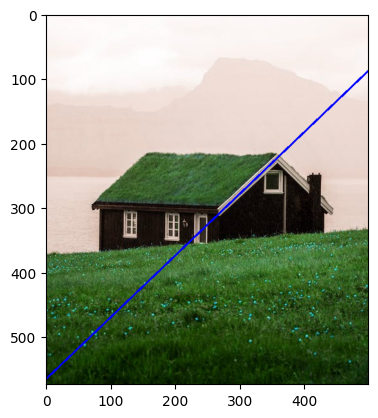

and the 

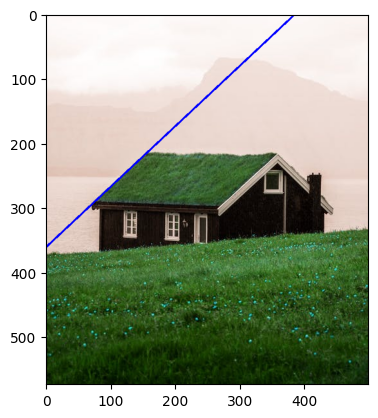

are approximately 43~44 degrees and the 

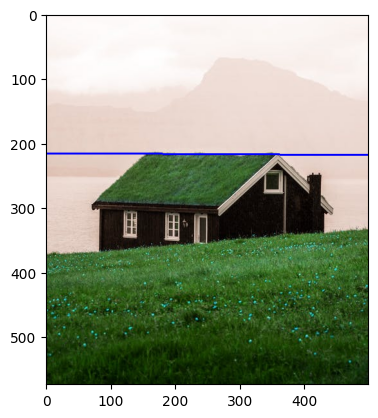

with the 


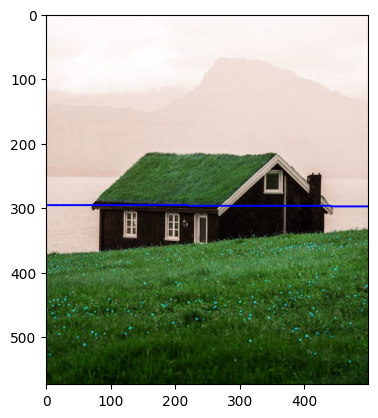


are -1~0 degrees with respect to the horizontal axis.


##Part 3##

*goodFeaturesToTrack*

In order to find the corners of the  image we can use the function goodFeaturesToTrack. This function uses the Shi-Tomasi method to find the N strongest corners in an image. It requires the input image to be in grayscale format. We can specify the number of corners you want to find and a quality level parameter (which should be a value between 0 and 1) that sets the minimum quality threshold of a corner. Additionally, we need to provide a minimum Euclidean distance between detected corners to avoid detecting too many corners in close proximity.

I chose to draw 80 corners with quality threshold of 0.01. We can esaily find much more corners if we change these parameters. 

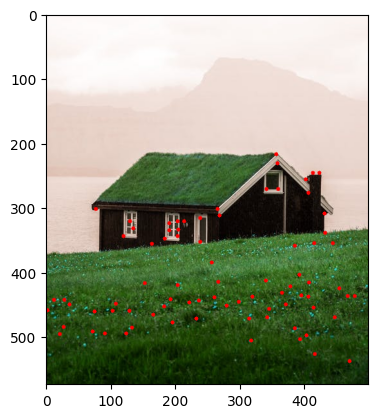

In [472]:
corners = cv2.goodFeaturesToTrack(gray, 80, 0.01, 10)
corners = np.int0(corners)
cornered = im_ex_6.copy()

  
# we iterate through each corner, 
# making a circle at each point that we think is a corner.
for i in corners:
    x, y = i.ravel()
    cv2.circle(cornered, (x, y), 3, 255, -1)
  
plt.imshow(cornered),
plt.show()

##Part 4##

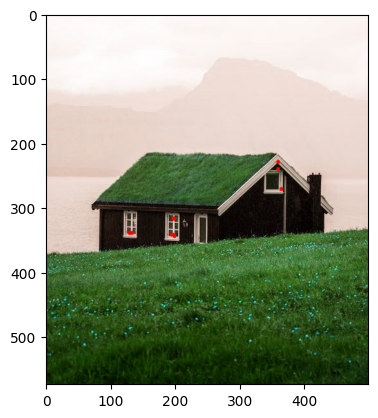

In [473]:
cornered_gray = cv2.cvtColor(im_ex_6, cv2.COLOR_BGR2GRAY)
cornered_color = im_ex_6.copy()
corners = cv2.goodFeaturesToTrack(edges_dilated,maxCorners = 100, qualityLevel = 0.6, minDistance = 0, blockSize = 20, useHarrisDetector = True, k = 0.2)
corners = np.int0(corners)

# we iterate through each corner,
# making a circle at each point that we think is a corner.
for i in corners:
    x, y = i.ravel()
    cv2.circle(cornered_color, (x, y), 3, 255, -1)
  
plt.imshow(cornered_color),
plt.show()

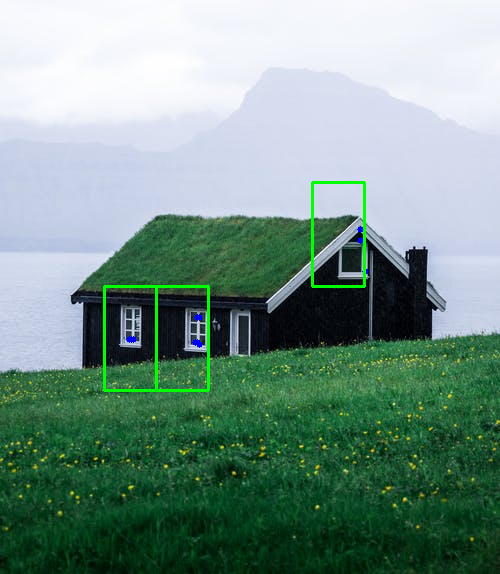

In [474]:
cornered_wind = cornered_color.copy()

# Create a 14x14 grid
num_rows =11
num_cols = 8
cell_size = cornered_wind.shape[0] // num_rows
grid = np.zeros((num_rows, num_cols))

# Count the number of corners in each cell of the grid
for corner in corners:
    x, y = corner.ravel()
    row = y // cell_size
    col = x // cell_size
    if row < num_rows and col < num_cols:
        grid[row, col] += 1

# Find the three cells with the highest corner count
window_locations = []
for i in range(3):
    row, col = np.unravel_index(grid.argmax(), grid.shape)
    grid[row, col] = 0
    x = col * cell_size + cell_size // 2
    y = row * cell_size + cell_size // 2
    window_locations.append((x, y))

# Draw rectangles around the window locations
for x, y in window_locations:
    x1 = x - cell_size // 2
    y1 = y - cell_size  
    x2 = x + cell_size // 2
    y2 = y + cell_size  
    cv2.rectangle(cornered_wind, (x1, y1), (x2, y2), (0, 255, 0), 2)

# Display the image with window locations marked
cv2_imshow(cornered_wind)
cv2.waitKey(0)
cv2.destroyAllWindows()

This is the best i can do to find the windows and fit them in a shape. I scose a vertigal rectangle because it fits better the shape of the windows. 

I increased the quality of the angles in order to find less angles but only the ones of the windows that had great quality. after that i separeted the image into boxes and tried to find with these boxes the spot thet the angles were found. I tried many different shaped which you can run at the following cell of code, I didn't include them at the notebook because they increased the size of the file.

In [ ]:
cornered_wind = cornered_color.copy()

for i in range(5, 25):
        for j in range(5, 25):
                cornered_wind = cornered_color.copy()
                num_rows = i
                num_cols = j
                cell_size = cornered_wind.shape[0] // num_rows
                grid = np.zeros((num_rows, num_cols))

                # Count the number of corners in each cell of the grid
                for corner in corners:
                    x, y = corner.ravel()
                    row = y // cell_size
                    col = x // cell_size
                    if row < num_rows and col < num_cols:
                        grid[row, col] += 1

                # Find the three cells with the highest corner count
                window_locations = []
                for k in range(3):
                    row, col = np.unravel_index(grid.argmax(), grid.shape)
                    grid[row, col] = 0
                    x = col * cell_size + cell_size // 2
                    y = row * cell_size + cell_size // 2
                    window_locations.append((x, y))

                # Draw rectangles around the window locations
                for x, y in window_locations:
                    x1 = x - cell_size // 2
                    y1 = y - cell_size  
                    x2 = x + cell_size // 2
                    y2 = y + cell_size  
                    cv2.rectangle(cornered_wind, (x1, y1), (x2, y2), (0, 255, 0), 2)

                # Display the image with window locations marked
                print(i,j)
                cv2_imshow(cornered_wind)
                cv2.waitKey(0)
                cv2.destroyAllWindows()

# Exercise 7#

a. Estimate the angle with respect to the horizontal axis of the billiard cue in image31.jpg. To
verify your answer, rotate the input image accordingly. The result should be similar to
image32.jpg.

Hint: Note that the billiard cue is the only object with straight edges.

b. Combine image31.jpg and image32.jpg to generate an image similar to image 33.jpg.

Hints:
• the billiard cue is the only object that matches to the pattern of a very long horizontal
line.
• it is very likely that the billiard cue is connected to a ball in a binary representation of
the image (and it would be useful to separate these objects)

In [222]:
im_ex_7_1 = cv2.imread('image31.png')
im_ex_7_2 = cv2.imread('image32.png')
im_ex_7_3 = cv2.imread('image33.png')

##Part 1##

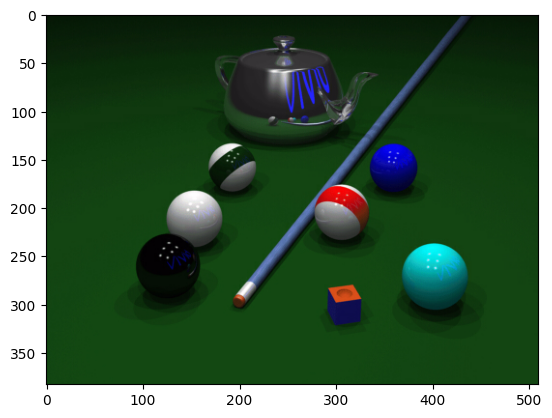

In [283]:
plt.imshow(im_ex_7_1)

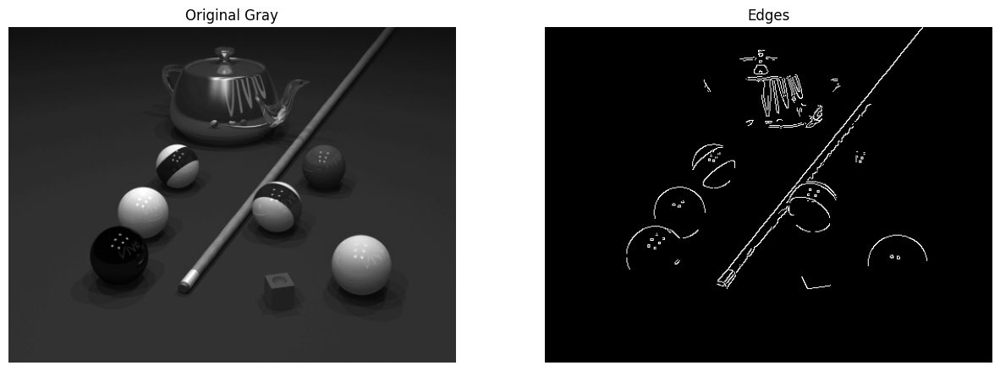

In [284]:
gray = cv2.cvtColor(im_ex_7_1, cv2.COLOR_BGR2GRAY)

edges = cv2.Canny(gray, 150, 200, apertureSize=3)

fig, axes = plt.subplots(1, 2, figsize=(15,7))

plt.subplot(121)
plt.imshow(gray, cmap='gray')
plt.title('Original Gray')
plt.axis('off')

# High pass filter
kernel = np.array([[0,-1,0],[-1,4,-1],[0,-1,0]], np.float32)
edges_1 = cv2.filter2D(gray, -1, kernel, borderType=cv2.BORDER_CONSTANT)

plt.subplot(122)
plt.imshow(edges, cmap='gray')
plt.title('Edges')
plt.axis('off')

plt.show()

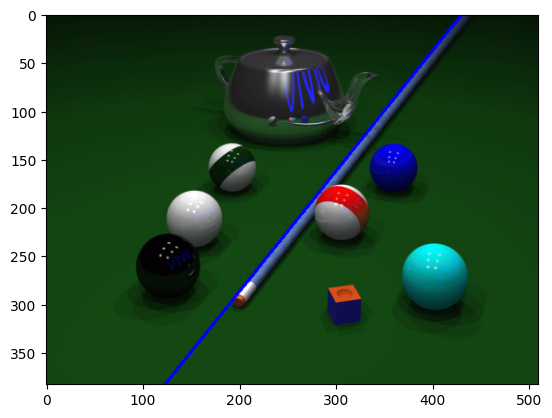

In [285]:
# This returns an array of r and theta values
lines = cv2.HoughLines(edges, rho=1, theta=np.pi/200, threshold=150 , min_theta=0, max_theta=np.pi/2 )

drawn_img=im_ex_7_1.copy()
# The below for loop runs till r and theta values
# are in the range of the 2d array

for r_theta in lines:
    arr = np.array(r_theta[0], dtype=np.float64)
    r, theta = arr
    angle_degrees = theta * 180 / np.pi
    if 10 <= angle_degrees <= 90 or 91 <= angle_degrees <= 179:
        # Stores the value of cos(theta) in a
        a = np.cos(theta)
        # Stores the value of sin(theta) in b
        b = np.sin(theta)
        # x0 stores the value rcos(theta)
        x0 = a*r
        # y0 stores the value rsin(theta)
        y0 = b*r
        # x1 stores the rounded off value of (rcos(theta)-1000sin(theta))
        x1 = int(x0 + 1000*(-b))
        # y1 stores the rounded off value of (rsin(theta)+1000cos(theta))
        y1 = int(y0 + 1000*(a))
        # x2 stores the rounded off value of (rcos(theta)+1000sin(theta))
        x2 = int(x0 - 1000*(-b))
        # y2 stores the rounded off value of (rsin(theta)-1000cos(theta))
        y2 = int(y0 - 1000*(a))
        # cv2.line draws a line in img from the point(x1,y1) to (x2,y2).
        # (0,0,255) denotes the colour of the line to be
        # drawn. In this case, it is red.
        cv2.line(drawn_img, (x1, y1), (x2, y2), (0, 0, 255), 2)
        
# All the changes made in the input image are finally
plt.imshow(drawn_img)

In [286]:
# Calculate slope of the line
m = (y2 - y1) / (x2 - x1)

# Calculate angle in degrees
angle_degrees = np.arctan(m) * 180 / np.pi

angle_degrees

-51.29987731150137

Which means that with respect with the horizontal axis the degrees are approximatelly 51.

In [287]:
gray_rotated = gray.copy()
ca = np.cos(np.deg2rad(angle_degrees))
sa = np.sin(np.deg2rad(angle_degrees))
R = np.array([[ca,-sa],[sa,ca]])
rMax,cMax = gray_rotated.shape[0],gray_rotated.shape[1]
Cords = np.array([[0,0],[0,cMax-1],[rMax-1,0],[rMax-1,cMax-1]])
A_dash = R.dot(Cords.T)
mins = A_dash.min(axis=1)
maxs = A_dash.max(axis=1)
minR = np.int64(np.floor(mins[0]))
minC = np.int64(np.floor(mins[1]))
maxR = np.int64(np.ceil(maxs[0]))
maxC = np.int64(np.ceil(maxs[1]))
H,W = maxR-minR+1, maxC-minC+1
gray_rotated = np.zeros((H,W),dtype='uint8')

In [288]:
def f_bilinearInterpolate(r,c,I):
    lc = int(c)
    rc = lc+1
    wr = c - lc
    wl = rc - c
    tr = int(r)
    br = tr+1
    wt = br-r
    wb = r-tr
    if tr >= 0 and br < I.shape[0] and lc >=0 and rc < I.shape[1]:
        a = wl*I[tr,lc] + wr*I[tr,rc]
        b = wl*I[br,lc] + wr*I[br,rc]
        g = wt*a + wb*b
        return np.uint8(g)
    else:
        return 0
        

In [289]:
numRows = gray_rotated.shape[0]
numCols = gray_rotated.shape[1]
Tinv = np.linalg.inv(R)
for new_i in range(minR,maxR):
    for new_j in range(minC,maxC):
        P_dash = np.array([new_i,new_j])
        P = Tinv.dot(P_dash)
        i , j = P[0] , P[1]
        if i < 0 or i>=numRows or j<0 or j>=numCols:
            pass
        else:
            g = f_bilinearInterpolate(i,j,gray)
            gray_rotated[new_i-minR,new_j-minC] = g

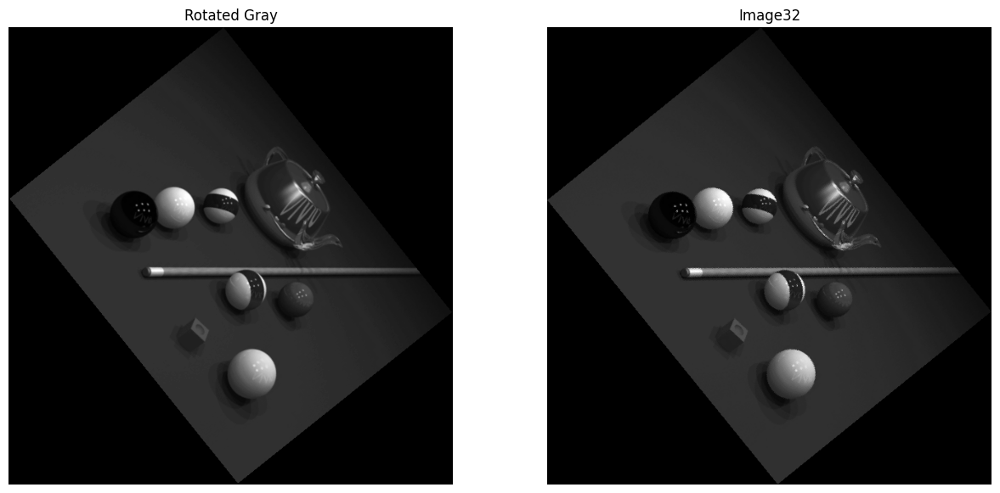

In [290]:
fig, axes = plt.subplots(1, 2, figsize=(15,7))
plt.subplot(121)
plt.imshow(gray_rotated, cmap='gray')
plt.title('Rotated Gray')
plt.axis('off')

plt.subplot(122)
plt.imshow(im_ex_7_2, cmap='gray')
plt.title('Image32')
plt.axis('off')

plt.show()

In [291]:
image2_only_gray = cv2.cvtColor(im_ex_7_2, cv2.COLOR_BGR2GRAY)

# Compute the mean squared error between the two images
mse = np.mean((gray_rotated - image2_only_gray)**2)

# Check if the images are identical based on the MSE
if mse == 0:
    print('The images are identical.')
else:
    print('The images are different.')

The images are different.


In [292]:
mse

2.895662941036458

The images are probably not exactly the same because the angle was found on approach. The differences that they have are minimally small according to the mse.

##Part 2##

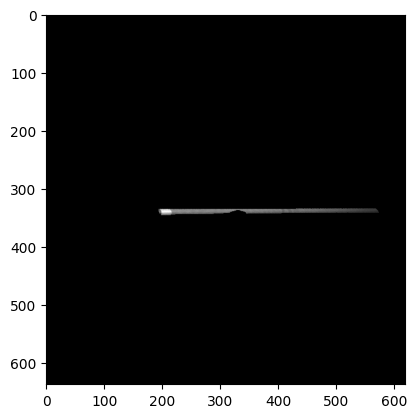

In [233]:
plt.imshow(im_ex_7_3)

The approach I took to solve this problem involved using the angle of the cue that was previously identified. I created two lines above and below the cue using the tanh of the angle and masked out everything that fell outside of them. Next, I observed that the grayscale tones below the steka were relatively dark, so I applied binary thresholding to mask them as well. Finally, I processed the second image by darkening it slightly to remove any unnecessary details, and then merged it with the first image.

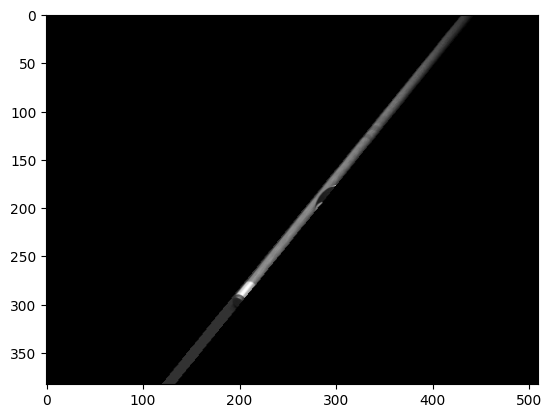

In [451]:
img = im_ex_7_1.copy()

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

plt.imshow(gray,cmap='gray')

for row in range(gray.shape[0]):
  for col in range(gray.shape[1]):
    if row+1.2350*col-530<=0:
      gray[row,col]=0
    elif row+1.2350*col-547>=0:
      gray[row,col]=0  


plt.imshow(gray,cmap='gray')


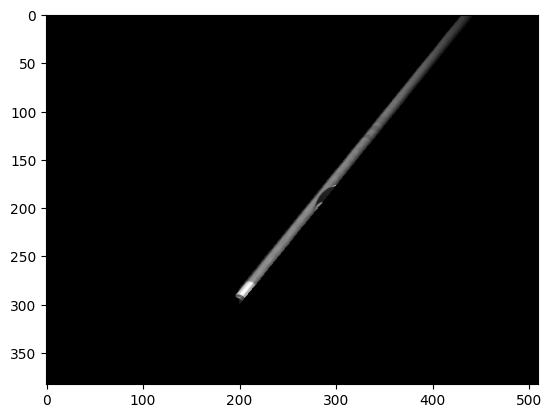

In [452]:
for row in range(250,gray.shape[0]):
  for col in range(100,200):
    if gray[row,col] < 70 : gray[row,col]=0
    else : continue

plt.imshow(gray,cmap='gray')

In [453]:
angle_degrees = -51.3

gray_rotated = gray.copy()
ca = np.cos(np.deg2rad(angle_degrees))
sa = np.sin(np.deg2rad(angle_degrees))
R = np.array([[ca,-sa],[sa,ca]])
rMax,cMax = gray_rotated.shape[0],gray_rotated.shape[1]
Cords = np.array([[0,0],[0,cMax-1],[rMax-1,0],[rMax-1,cMax-1]])
A_dash = R.dot(Cords.T)
mins = A_dash.min(axis=1)
maxs = A_dash.max(axis=1)
minR = np.int64(np.floor(mins[0]))
minC = np.int64(np.floor(mins[1]))
maxR = np.int64(np.ceil(maxs[0]))
maxC = np.int64(np.ceil(maxs[1]))
H,W = maxR-minR+1, maxC-minC+1
gray_rotated = np.zeros((H,W),dtype='uint8')

numRows = gray_rotated.shape[0]
numCols = gray_rotated.shape[1]
Tinv = np.linalg.inv(R)
for new_i in range(minR,maxR):
    for new_j in range(minC,maxC):
        P_dash = np.array([new_i,new_j])
        P = Tinv.dot(P_dash)
        i , j = P[0] , P[1]
        if i < 0 or i>=numRows or j<0 or j>=numCols:
            pass
        else:
            g = f_bilinearInterpolate(i,j,gray)
            gray_rotated[new_i-minR,new_j-minC] = g



In [458]:
gray_2 = cv2.cvtColor(im_ex_7_2, cv2.COLOR_BGR2GRAY)

for row in range(gray_2.shape[0]):
  for col in range(gray_2.shape[1]):
    if gray_2[row,col] > 70: gray_2[row,col]=0
    else: continue

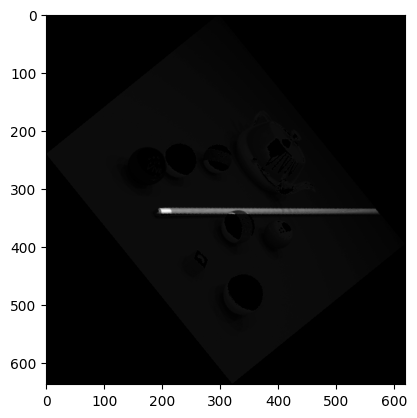

In [460]:
final_img = cv2.addWeighted(gray_rotated, 0.8, gray_2, 0.2, 0)

plt.imshow(final_img, cmap='gray')